# Linestring data

In [1]:
import geopandas as gpd
import folium
import json
import branca

# Linestring data formats

## Shapefiles

Let's read a shapefiles contains linestrings

In [2]:
max_speed_df = gpd.read_file('Data/linestring/max_snelheden.shp', rows=5000) # only the first 1000 records

First few rows in the data

In [3]:
max_speed_df.head()

,OMSCHR,KANTCODE,WVK_ID,WVK_BEGDAT,BEGAFSTAND,ENDAFSTAND,BEGINTIJD,EINDTIJD,FK_VELD1,FK_VELD4,IZI_SIDE,IBN,geometry
0,30,H,129165005,2014-11-01,0,334,NaN,NaN,012916500520141101,KLK0008311442,L,I,"LINESTRING (64557.000 382675.000, 64669.000 38..."
1,30,H,191191019,2014-11-01,0,104,NaN,NaN,019119101920141101,KLK0008311153,L,I,"LINESTRING (95747.000 395869.000, 95843.706 39..."
2,100,H,315388011,2014-11-01,0,91,6.0,19.0,031538801120141101,KLK0008638133,R,I,"LINESTRING (157668.000 494178.000, 157724.021 ..."
3,130,H,315388011,2014-11-01,0,91,19.0,6.0,031538801120141101,KLK0008638132,R,I,"LINESTRING (157668.000 494178.000, 157724.021 ..."
4,100,H,406338025,2014-11-01,0,125,6.0,19.0,040633802520141101,KLK0008630677,R,I,"LINESTRING (203341.692 469190.184, 203385.000 ..."


This geospatial data represent speed limits on various roadways in the Netherlands. The roads are defined by linestrings - the rightmost column - `geometry`

The first linestring is defined by a sequence of 3 points

In [4]:
print(max_speed_df.geometry[0])

LINESTRING (64557 382675, 64669 382599, 64831 382484)


We can plot the first line

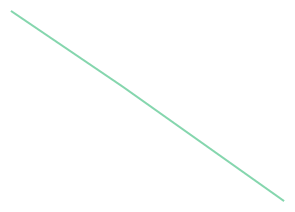

In [5]:
max_speed_df.geometry[0]

# Linesting data visualisation

## Base map

First, create a base map and specify the center with respect to the speed limit data

In [6]:
map = folium.Map(
    location=[
        max_speed_df.geometry.to_crs('EPSG:4326').bounds.miny.mean(),
        max_speed_df.geometry.to_crs('EPSG:4326').bounds.minx.mean()
    ],
    zoom_start=10
)
map

## GeoJson overlay

Similar to the point data, we can include all the linestrings into a GeoJson overlay over the base map

In [7]:
gjson = folium.features.GeoJson(
    max_speed_df,
).add_to(map)
map

The overlay only shows the linestrings without any further information like speed limits. We can make it more informative by changing the line colors according to speed limits.

First, we create a color map

In [8]:
colorscale = branca.colormap.linear.RdYlBu_11.scale(0, max_speed_df.OMSCHR.max())

In [9]:
colorscale

To customise the visualisation of a linestring, we can define a `style_function` function which takes all information related to a string as input. This input is essentially the whole row in our data frame.  
The following function sets the color according to speed limit on the related linestring (i.e. road)

In [10]:
def style_function(feature):
    return {
        "fillOpacity": 0.5,
        "weight": 5,
        "color": colorscale(max_speed_df.iloc[int(feature['id'])]['OMSCHR']),
    }

Now, we can create another overlay with the customised style settings

In [11]:
gjson = folium.features.GeoJson(
    # geojson,
    max_speed_df,
    # json.loads(geo),
    style_function=style_function,
).add_to(map)
map

## Popup

We can specify features to be poped up when a linestring is being clicked on

In [12]:
folium.features.GeoJsonPopup(
    fields=['WVK_ID', 'BEGAFSTAND', 'ENDAFSTAND', 'OMSCHR'],
    aliases=['WVK_ID', 'from', 'to', 'Maximum speed'],
    labels=True
).add_to(gjson)
map